[![image](https://raw.githubusercontent.com/visual-layer/visuallayer/main/imgs/vl_horizontal_logo.png)](https://www.visual-layer.com)

# Optical Character Recognition

This notebook shows how you can use fastdup to extract optical characters on your video/image dataset.

We will be using fastdup with [PaddleOCR](https://github.com/PaddlePaddle/PaddleOCR) - A lightweight, multilingual optical character recognition package. 

In [1]:
!pip install -Uqq fastdup paddleocr paddlepaddle gdown numpy

In [2]:
import fastdup
fastdup.__version__

/usr/bin/dpkg


'1.34'

If you're running this notebook in Google Colab, uncomment the following cell and run before proceeding to the next cell.

In [ ]:
# !wget http://nz2.archive.ubuntu.com/ubuntu/pool/main/o/openssl/libssl1.1_1.1.1f-1ubuntu2.19_amd64.deb
# !sudo dpkg -i libssl1.1_1.1.1f-1ubuntu2.19_amd64.deb

## Download Video Dataset
We'll use a subset of the [TikTok Trending Videos](https://www.kaggle.com/datasets/erikvdven/tiktok-trending-december-2020) dataset from Kaggle.

In [3]:
!gdown https://drive.google.com/uc?id=1FsBQTZKsfApEn99g_BhkTbdz0SmQgkKv

Downloading...
From (uriginal): https://drive.google.com/uc?id=1FsBQTZKsfApEn99g_BhkTbdz0SmQgkKv
From (redirected): https://drive.google.com/uc?id=1FsBQTZKsfApEn99g_BhkTbdz0SmQgkKv&confirm=t&uuid=2e6206bc-cbe1-4642-a0f9-f849a42c4b6e
To: /media/dnth/Active-Projects/fastdup/examples/tiktok-trending-subset.zip
100%|██████████████████████████████████████| 61.3M/61.3M [00:06<00:00, 9.67MB/s]


Now, unzip the dataset into our local directory. You'll find a folder name `tiktok-trending-subset` that has all the trending clips.

In [4]:
!unzip -q tiktok-trending-subset.zip

## Extract frames
To run fastdup, we will need to extract the clips in the `tiktok-trending-subset` folder into frames and store them in another folder, let's name the folder `frames`. fastdup provides a convenience function for that.

In [5]:
fastdup.extract_video_frames('tiktok-trending-subset', 'frames')

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
2023-08-09 16:17:49 [INFO] Going to loop over dir tiktok-trending-subset
2023-08-09 16:17:49 [INFO] Found total 19 videos to run on, 19 train, 0 test, name list 19, counter 19 


0

## Run fastdup
With the extracted frames, we can run fastdup to analyze them. 

To use the optical character recognition feature, specify `bounding_box='ocr'` in the `run` method.

For demonstration, we'll specify `num_images=1000` in the `run` method which limits the run to only 1000 images. Feel free to specify a different value or omitting this parameter altogether to run on the entire dataset.

In [6]:
fd = fastdup.create(input_dir='./frames')
fd.run(bounding_box='ocr')

FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
2023-08-09 16:17:52 [INFO] Going to loop over dir frames
2023-08-09 16:17:52 [INFO] Found total 54 images to run on, 54 train, 0 test, name list 54, counter 54 
FastDup Software, (C) copyright 2022 Dr. Amir Alush and Dr. Danny Bickson.
2023-08-09 16:18:45 [INFO] Going to loop over dir /tmp/crops_input.csv
2023-08-09 16:18:45 [INFO] Found total 259 images to run on, 259 train, 0 test, name list 259, counter 259 
2023-08-09 16:18:46 [INFO] Found total 259 images to run onstimated: 0 Minutes
Finished histogram 0.280
Finished bucket sort 0.294
2023-08-09 16:18:46 [INFO] 31) Finished write_index() NN model
2023-08-09 16:18:46 [INFO] Stored nn model index file work_dir/nnf.index
2023-08-09 16:18:46 [INFO] Total time took 1043 ms
2023-08-09 16:18:46 [INFO] Found a total of 83 fully identical images (d>0.990), which are 16.02 %
2023-08-09 16:18:46 [INFO] Found a total of 57 nearly identical images(d>0.980), which are 11

0

## Extracted OCR Information

In [7]:
stats = fd.img_stats()
stats.head()

,index,img_w,img_h,unique,blur,mean,min,max,stdv,file_size,contrast,filename,crop_filename,x1,y1,x2,y2,x3,y3,x4,y4,confidence,label,is_valid
0,0,24,14,183,345.0356,178.0270,51.0,255.0,57.0515,916,0.6667,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_436_953_456_953_456_965_436_965.jpg,436,953,456,953,456,965,436,965,0.662398,1,True
1,1,112,36,195,688.3301,180.5150,41.0,255.0,47.7177,2614,0.7230,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_466_945_560_945_560_975_466_975.jpg,466,945,560,945,560,975,466,975,0.785349,TikTok,True
2,2,108,28,186,739.3006,164.1137,70.0,255.0,40.6979,2074,0.5692,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_472_983_562_986_562_1008_471_1006.jpg,472,983,562,986,562,1008,471,1006,0.989322,@caitlinjs,True
3,3,106,35,159,208.8422,222.4114,48.0,255.0,22.7722,2404,0.6832,frames/tmp/tiktok-trending-subset6875323773755657474.mp4/output_000001.jpg,work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_61_26_149_26_149_55_61_55.jpg,61,26,149,26,149,55,61,55,0.829294,TikTOK,True
4,4,159,25,95,360.8476,215.8326,0.0,255.0,29.6220,1811,1.0000,frames/tmp/tiktok-trending-subset6875323773755657474.mp4/output_000001.jpg,work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_12_66_146_66_146_87_12_87.jpg,12,66,146,66,146,87,12,87,0.990695,@marc.koolen,True


That's a lot of information. Let's slice the table to only include the columns we need.

In [8]:
df = stats[["filename", "crop_filename", "label"]]
df

,filename,crop_filename,label
0,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_436_953_456_953_456_965_436_965.jpg,1
1,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_466_945_560_945_560_975_466_975.jpg,TikTok
2,frames/tmp/tiktok-trending-subset6875373441432816898.mp4/output_000002.jpg,work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000002.jpg_472_983_562_986_562_1008_471_1006.jpg,@caitlinjs
3,frames/tmp/tiktok-trending-subset6875323773755657474.mp4/output_000001.jpg,work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_61_26_149_26_149_55_61_55.jpg,TikTOK
4,frames/tmp/tiktok-trending-subset6875323773755657474.mp4/output_000001.jpg,work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_12_66_146_66_146_87_12_87.jpg,@marc.koolen
...,...,...,...
254,frames/tmp/tiktok-trending-subset6875872124968439046.mp4/output_000006.jpg,work_dir/crops/framestmptiktok-trending-subset6875872124968439046.mp4output_000006.jpg_78_604_308_604_308_622_78_622.jpg,haveadecentamountof
255,frames/tmp/tiktok-trending-subset6875872124968439046.mp4/output_000006.jpg,work_dir/crops/framestmptiktok-trending-subset6875872124968439046.mp4output_000006.jpg_78_628_317_628_317_650_78_650.jpg,bruisingandpainwithmy
256,frames/tmp/tiktok-trending-subset6875872124968439046.mp4/output_000006.jpg,work_dir/crops/framestmptiktok-trending-subset6875872124968439046.mp4output_000006.jpg_77_654_168_654_168_672_77_672.jpg,newlever
257,frames/tmp/tiktok-trending-subset6875872124968439046.mp4/output_000006.jpg,work_dir/crops/framestmptiktok-trending-subset6875872124968439046.mp4output_000006.jpg_433_946_561_946_561_976_433_976.jpg,JTikTok


Let's use a handy package [itables](https://github.com/mwouts/itables) to visualize the images in table interactively.

In [9]:
!pip install -Uqq itables

Now, we run the function below to convert the path into HTML tags so we can preview the images here.

In [10]:
import base64
from itables import init_notebook_mode, show
init_notebook_mode(all_interactive=True)

# Convert the image file paths into HTML tag for preview
def to_img_tag(path):
    if isinstance(path, str):
        with open(path, 'rb') as f:
            image_data = f.read()
            base64_image = base64.b64encode(image_data).decode('utf-8')
        return '<img src="data:image/png;base64,' + base64_image + '" width="150" >'
    else:
        return path

df["filename_preview"] = df["filename"].apply(to_img_tag)
df["crop_filename_preview"] = df["crop_filename"].apply(to_img_tag)

df = df.loc[:,["filename","filename_preview", "crop_filename", "crop_filename_preview",  "label"],]

<IPython.core.display.Javascript object>


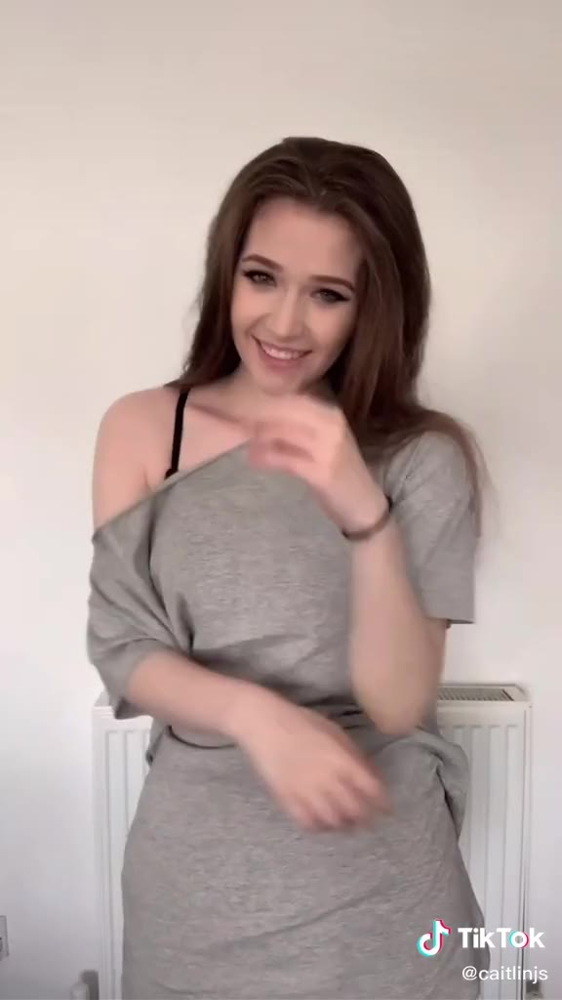
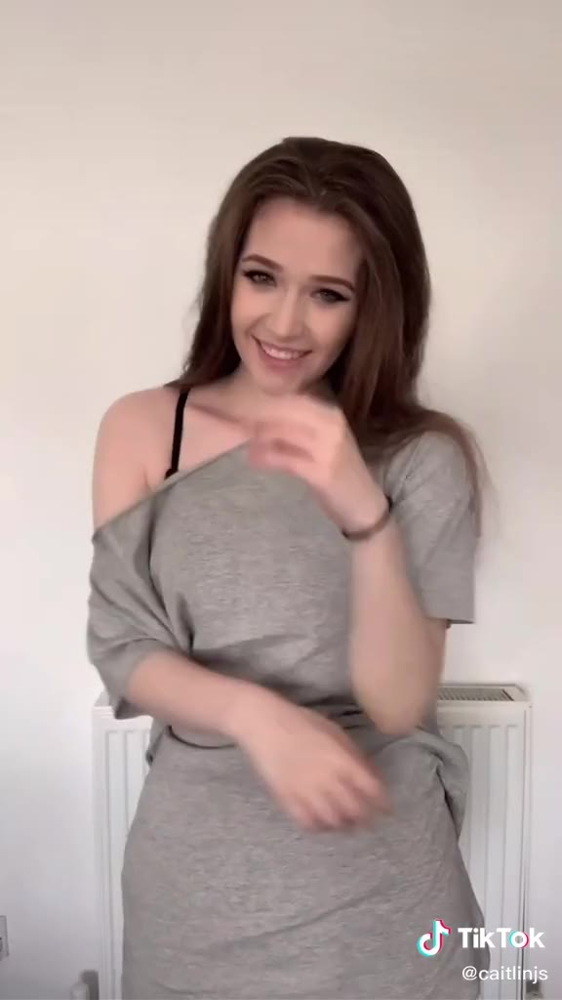
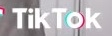
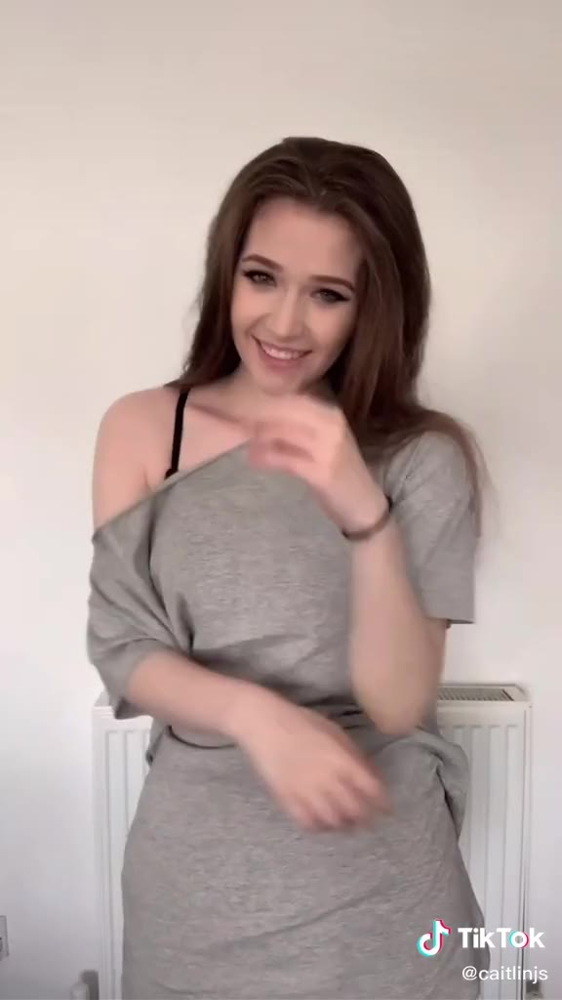
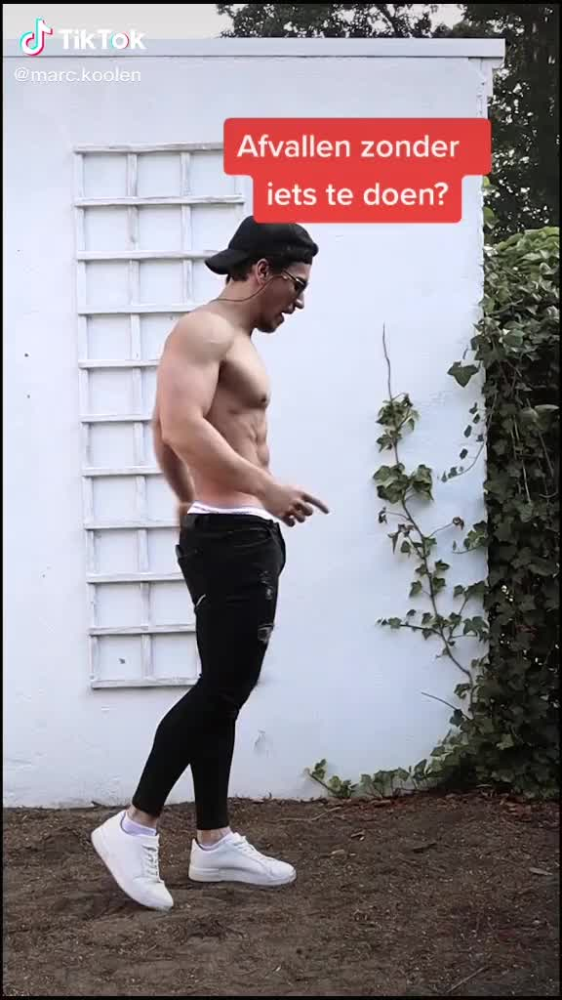
...
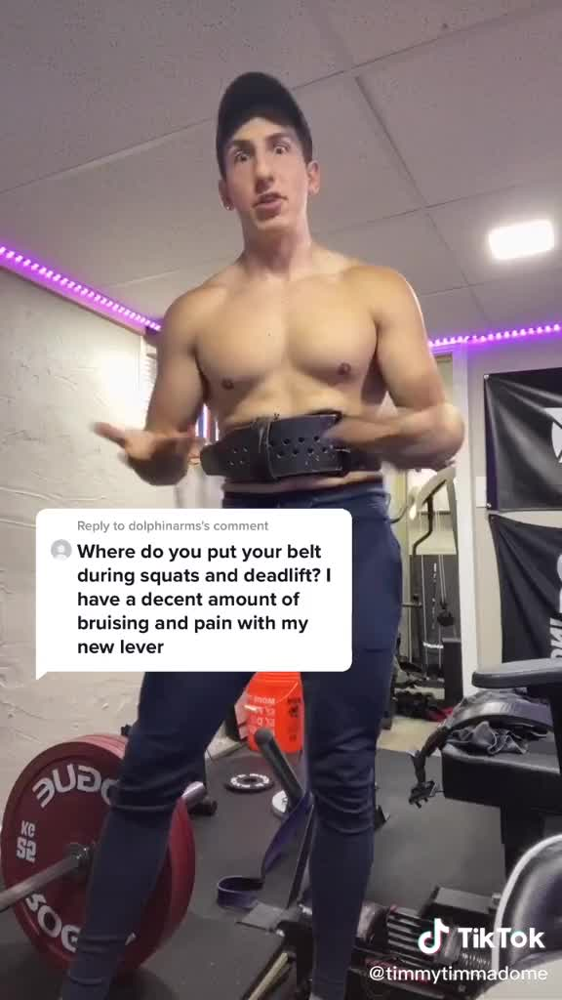
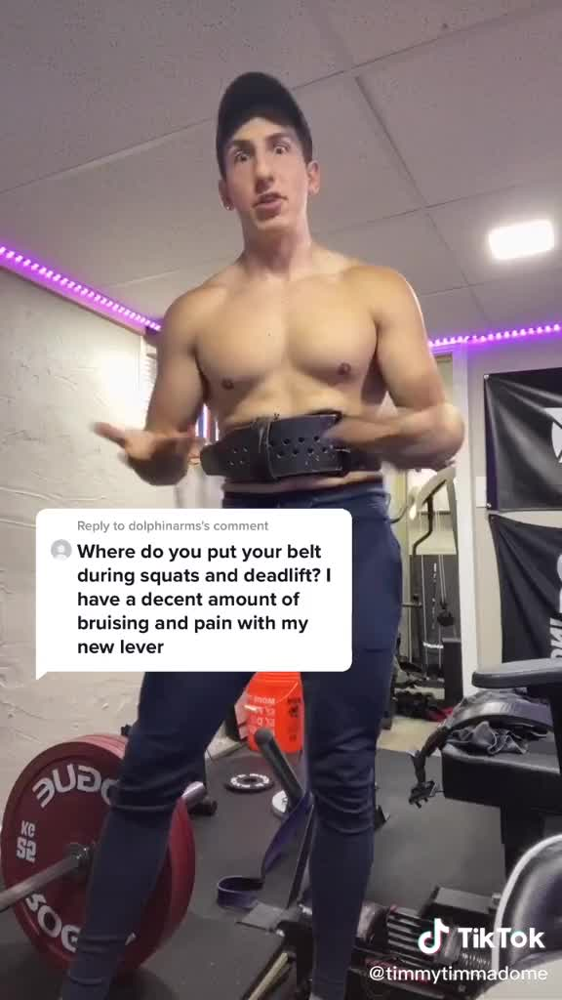
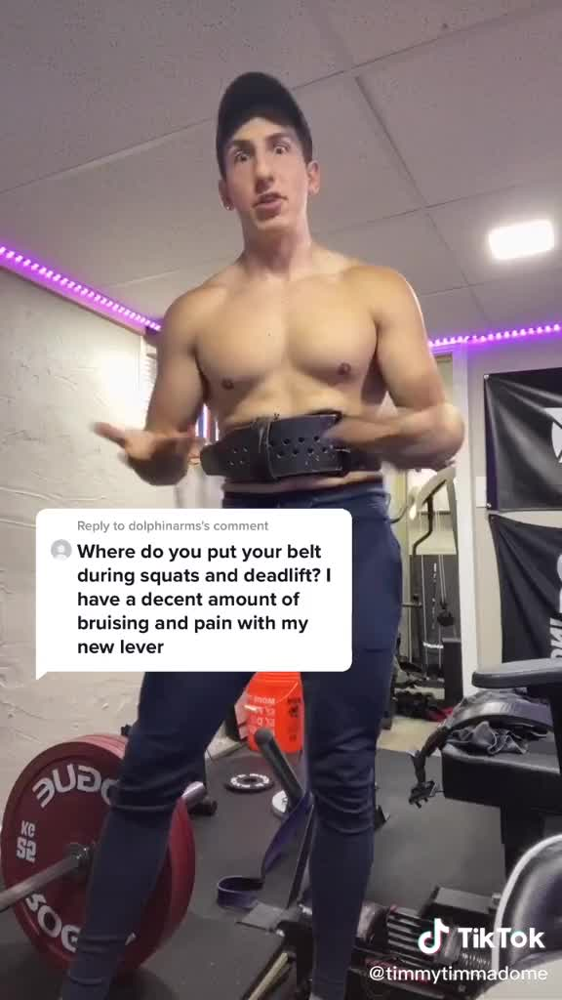
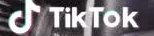
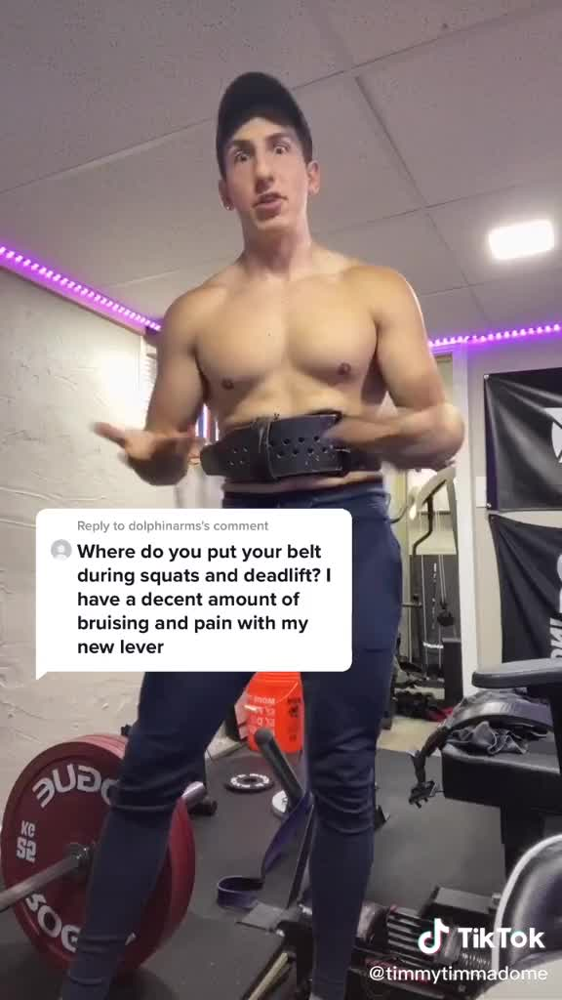

In [11]:
show(df, classes="display compact")

## Duplicate/Near-duplicate Detections

100%|█| 20/20 [00:00<00:00, 468.54it


Stored similarity visual view in  work_dir/galleries/duplicates.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



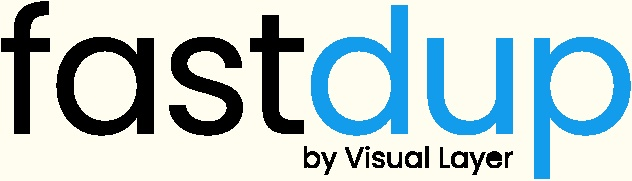
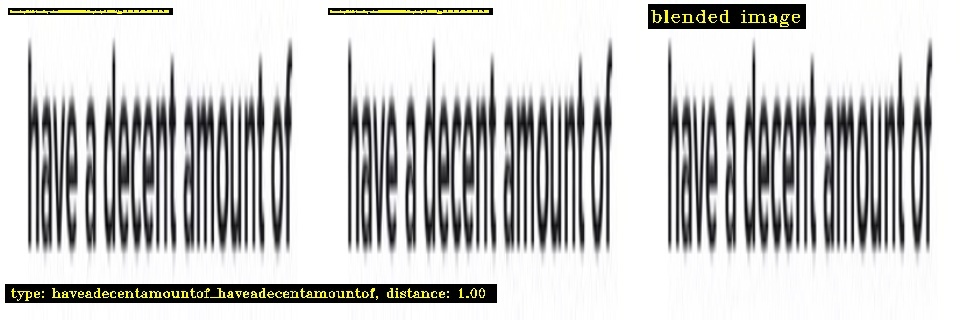
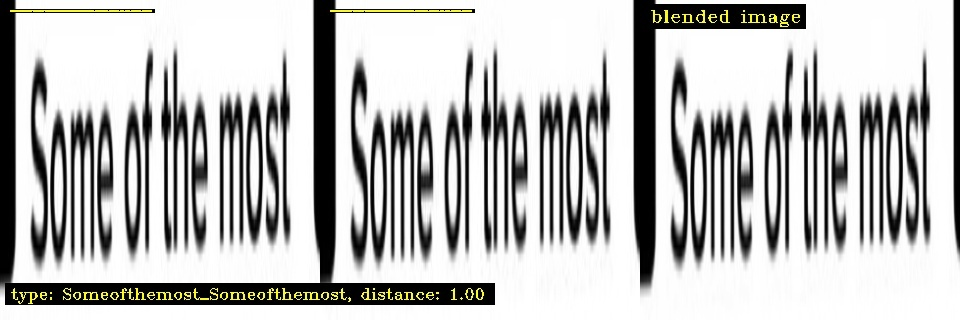
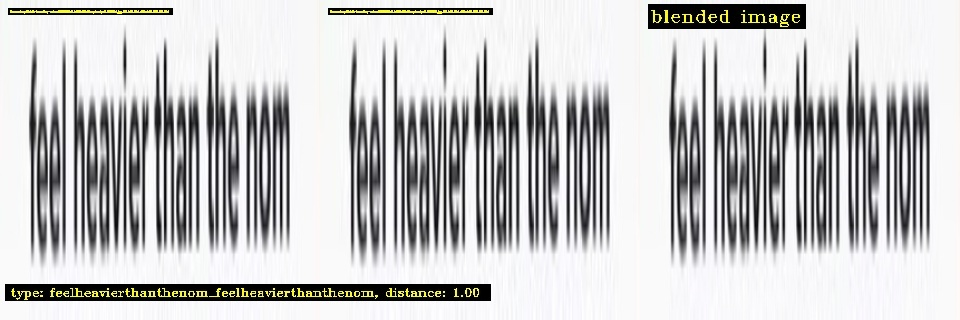
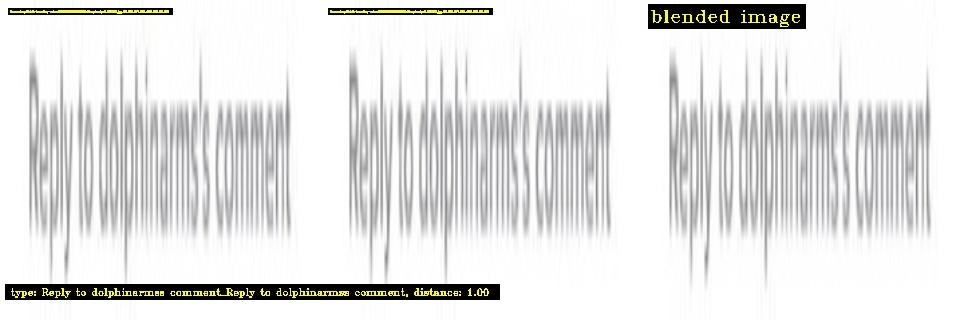
...
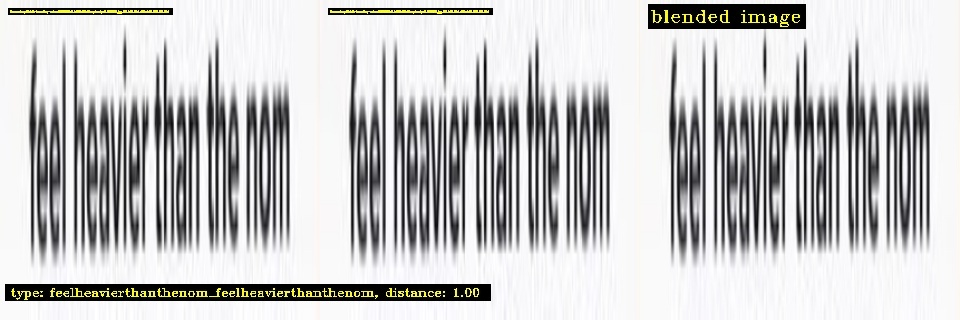
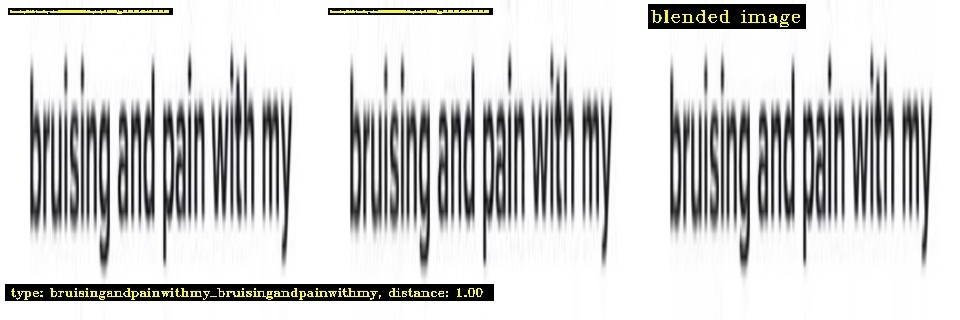
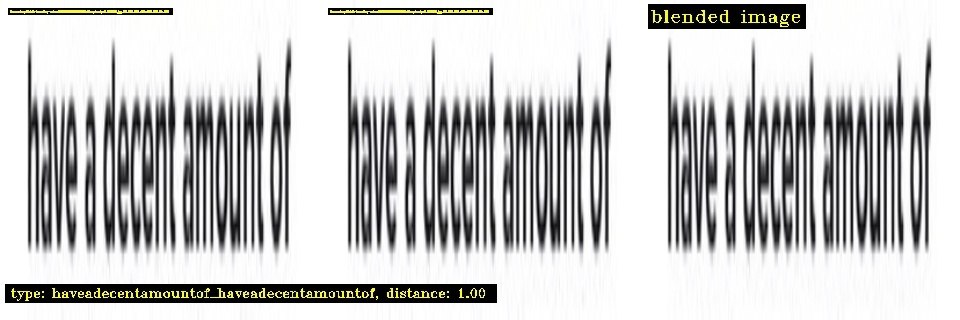
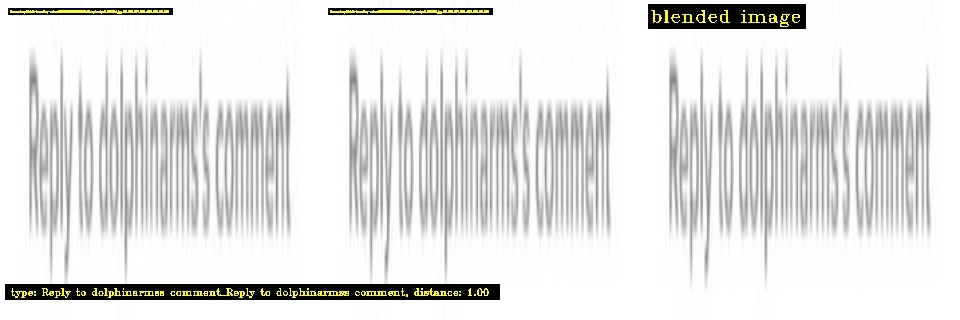
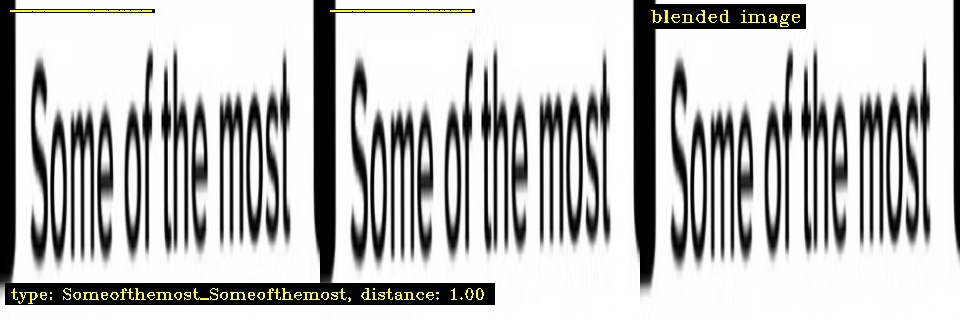

0

In [12]:
fd.vis.duplicates_gallery()

## Outliers

Let's visualize the outliers in the OCR detections.

100%|█| 20/20 [00:00<00:00, 27603.19

Stored outliers visual view in  work_dir/galleries/outliers.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



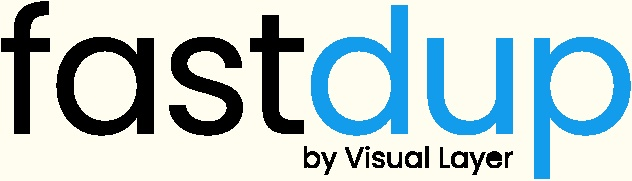
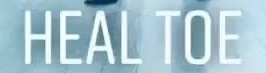
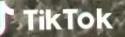
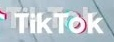
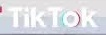
...
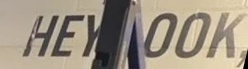
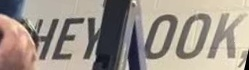
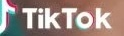
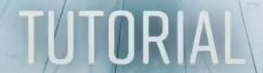
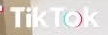

0

In [13]:
fd.vis.outliers_gallery(load_crops=True)

## Blurry Detections

100%|█| 20/20 [00:00<00:00, 216.36it


Stored blur visual view in  work_dir/galleries/blur.html
########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



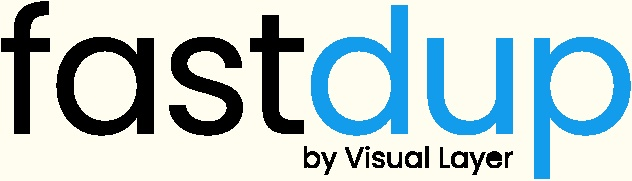
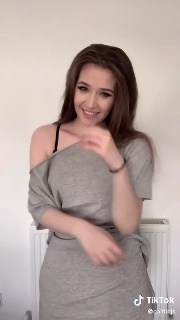
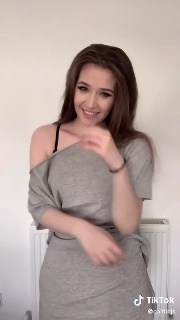
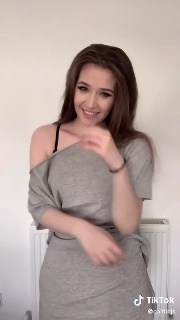
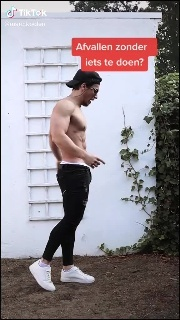
...
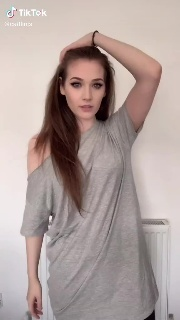
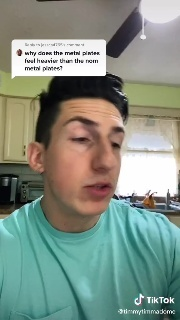
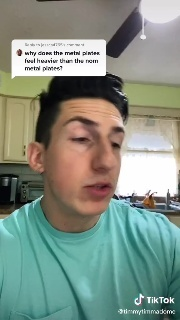
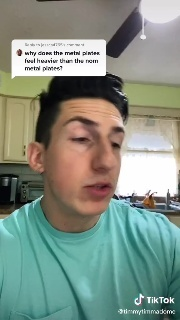
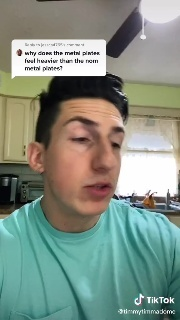

0

In [15]:
fd.vis.stats_gallery(metric='blur', load_crops=True)

## Detection Clusters

TikTok


100%|█| 20/20 [00:00<00:00, 713.79it

Finished OK. Components are stored as image files work_dir/galleries/components_[index].jpg
Stored components visual view in  work_dir/galleries/components.html
Execution time in seconds 0.1


########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



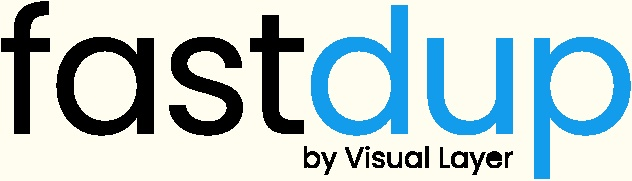
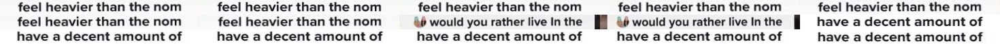
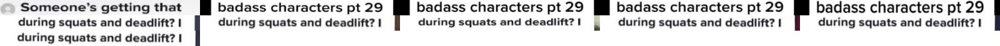
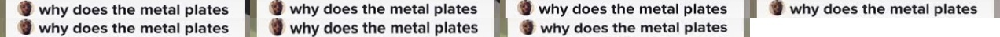
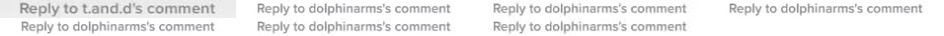
...
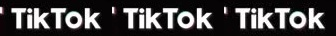
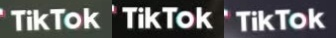
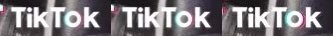
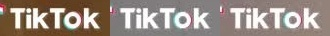
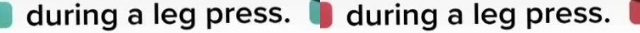

0

In [16]:
fd.vis.component_gallery()

## Similarity Gallery
We can compare the detections with two of it's nearest neighbors to see if there are discrepencies in labels.

100%|█| 20/20 [00:00<00:00, 322.32it

Stored similar images visual view in  work_dir/galleries/similarity.html


########################################################################################
Would you like to see awesome visualizations for some of the most popular academic datasets?
Click here to see and learn more: https://app.visual-layer.com/vl-datasets?utm_source=fastdup
########################################################################################



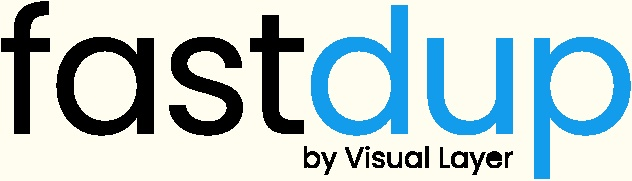
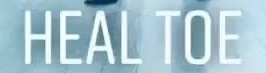
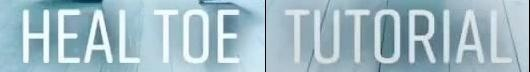
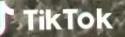
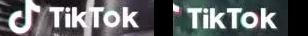
...
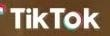
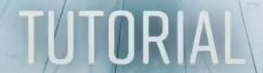
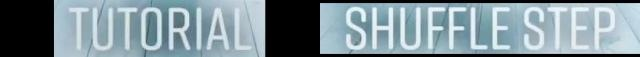
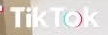
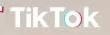

from                                                                                                                                                                                                                                                        to                                                           label                                                          label2              distance
85   work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000001.jpg_162_662_384_662_384_723_162_723.jpg  [work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000001.jpg_162_853_381_853_381_913_162_913.jpg, work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000002.jpg_164_663_385_663_385_723_164_723.jpg]                                            [HEAL TOE, HEAL TOE]                                             [TUTORIAL, HEALTOE]  [0.900267, 0.964309]
121  work_dir/crops/framestmptiktok-trending-subset6875651291343883522.mp4output_000002.jpg_457_943_561_945_561_976_456_974.jpg        [work_dir/crops/framestmptiktok-trending-subset6875317312082201857.mp4output_000001.jpg_56_25_151_25_151_55_56_55.jpg, work_dir/crops/framestmptiktok-trending-subset6875872124968439046.mp4output_000006.jpg_433_946_561_946_561_976_433_976.jpg]                                                [TikTok, TikTok]                                               [TikTok, JTikTok]  [0.901725, 0.906236]
91   work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000002.jpg_464_940_559_940_559_975_464_975.jpg              [work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000001.jpg_59_25_150_25_150_55_59_55.jpg, work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000001.jpg_59_26_151_26_151_55_59_55.jpg]                                                [TiKTOK, TiKTOK]                                                [TikTok, TikToK]  [0.901787, 0.924796]
2          work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_12_66_146_66_146_87_12_87.jpg                                                                                                                                    [work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000001.jpg_13_67_119_69_118_89_13_86.jpg]                                                  [@marc.koolen]                                                     [@catocade]            [0.902096]
84         work_dir/crops/framestmptiktok-trending-subset6875453919879908614.mp4output_000001.jpg_13_67_119_69_118_89_13_86.jpg              [work_dir/crops/framestmptiktok-trending-subset6875323773755657474.mp4output_000001.jpg_12_66_146_66_146_87_12_87.jpg, work_dir/crops/framestmptiktok-trending-subset6875373441432816898.mp4output_000001.jpg_11_63_105_66_104_90_10_86.jpg]                                          [@catocade, @catocade]                                      [@marc.koolen, @caitlinjs]  [0.902096, 0.925524]
..                                                                                                                          ...                                                                                                                                                                                                                                                       ...                                                             ...                                                             ...                   ...
69   work_dir/crops/framestmptiktok-trending-subset6875436892226178305.mp4output_000002.jpg_153_239_424_242_423_272_152_269.jpg  [work_dir/crops/framestmptiktok-trending-subset6875436892226178305.mp4output_000003.jpg_153_239_424_242_423_272_152_269.jpg, work_dir/crops/framestmptiktok-trending-subset6875436892226178305.mp4output_000004.jpg_153_239_424_242_423_272_152_269.jpg]                                  [Someofthemost, 

In [17]:
fd.vis.similarity_gallery()

## Wrap Up

In this notebook we show how you can run OCR models with fastdup and analyze the bounding boxes for issues.

Next, feel free to check out other tutorials -

+ ⚡ [**Quickstart**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/quick-dataset-analysis.ipynb): Learn how to install fastdup, load a dataset and analyze it for potential issues such as duplicates/near-duplicates, broken images, outliers, dark/bright/blurry images, and view visually similar image clusters. If you're new, start here!
+ 🧹 [**Clean Image Folder**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/cleaning-image-dataset.ipynb): Learn how to analyze and clean a folder of images from potential issues and export a list of problematic files for further action. If you have an unorganized folder of images, this is a good place to start.
+ 🖼 [**Analyze Image Classification Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-image-classification-dataset.ipynb): Learn how to load a labeled image classification dataset and analyze for potential issues. If you have labeled ImageNet-style folder structure, have a go!
+ 🎁 [**Analyze Object Detection Dataset**](https://nbviewer.org/github/visual-layer/fastdup/blob/main/examples/analyzing-object-detection-dataset.ipynb): Learn how to load bounding box annotations for object detection and analyze for potential issues. If you have a COCO-style labeled object detection dataset, give this example a try. 


# VL Profiler
If you prefer a no-code platform to inspect and visualize your dataset, [**try our free cloud product VL Profiler**](https://app.visual-layer.com) - VL Profiler is our first no-code commercial product that lets you visualize and inspect your dataset in your browser. 

[Sign up](https://app.visual-layer.com) now, it's free.

[![image](https://raw.githubusercontent.com/visual-layer/fastdup/main/gallery/vl_profiler_promo.svg)](https://app.visual-layer.com)

As usual, feedback is welcome! 

Questions? Drop by our [Slack channel](https://visualdatabase.slack.com/join/shared_invite/zt-19jaydbjn-lNDEDkgvSI1QwbTXSY6dlA#/shared-invite/email) or open an issue on [GitHub](https://github.com/visual-layer/fastdup/issues).

<center> 
    <a href="https://github.com/visual-layer/fastdup" target="_blank" style="text-decoration: none;"> GitHub </a> •
    <a href="https://visual-layer.slack.com/" target="_blank" style="text-decoration: none;"> Join Slack community </a> •
    <a href="https://visual-layer.readme.io/discuss" target="_blank" style="text-decoration: none;"> Discussion Forum </a>
</center>

<center> 
    <a href="https://medium.com/visual-layer" target="_blank" style="text-decoration: none;"> Blog </a> •
    <a href="https://visual-layer.readme.io/" target="_blank" style="text-decoration: none;"> Documentation </a> •
    <a href="https://visual-layer.com/about" target="_blank" style="text-decoration: none;"> About Us </a> 
</center>

<center> 
    <a href="https://www.linkedin.com/company/visual-layer/" target="_blank" style="text-decoration: none;"> LinkedIn </a> •
    <a href="https://twitter.com/visual_layer" target="_blank" style="text-decoration: none;"> Twitter </a>
</center>